<a href="https://colab.research.google.com/github/kikosikera/2019_09_20_py_sql/blob/master/2019_09_20_py_sql_b.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## Business Insights with SQL and Python

### NTBK B -  Demographics

### Applied Criteria
• Create a Demographics database with tables and variables combining crime rate, population growth, housing growth and penetration of top segments.

• Convert Query Results to DataFrames. Normalize variables to the same scale and calculate attractiveness score.

• Assign the Results of Queries to a final score, rank the cities and create a combined strategy.

## Import Libraries and Datasets
Assigning Dataframes into tables to create a full master Database

In [0]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib as mpl
mpl.style.use('ggplot')
import sqlite3

In [0]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [0]:
# survey - Survey Data will have the segment distribution for the variables providing the right attribute which will be used to calculate propensity indices for the segments or markets
df_survey = pd.read_csv("/content/drive/My Drive/Colab Notebooks/Data/PROJ/2019_09_20_py_sql/data/01_survey_data.csv", sep = ',', low_memory=False)
# segments - Segments and their description
df_segments = pd.read_csv("/content/drive/My Drive/Colab Notebooks/Data/PROJ/2019_09_20_py_sql/data/02_city_segments.csv", sep = ',', low_memory=False)
# demographics - Market data will have attributes like combine crime rate, population growth, housing growth and penetration of top segments at state city level
df_demographics = pd.read_csv("/content/drive/My Drive/Colab Notebooks/Data/PROJ/2019_09_20_py_sql/data/03_citywise_demographics.csv", sep = ',', low_memory=False)

In [0]:
df_survey.columns = df_survey.columns.str.strip().str.lower().str.replace(' ', '_').str.replace('(', '').str.replace(')', '')
df_segments.columns = df_segments.columns.str.strip().str.lower().str.replace(' ', '_').str.replace('(', '').str.replace(')', '')
df_demographics.columns = df_demographics.columns.str.strip().str.lower().str.replace(' ', '_').str.replace('(', '').str.replace(')', '')

Assigning df_survey into a SQL table





In [0]:
# Create database connection
# Create tables into the database
conn = sqlite3.connect("01_survey_data.db")
c=conn.cursor()
c.execute("CREATE TABLE IF NOT EXISTS survey ({})".format(' ,'.join(df_survey.columns)))

In [0]:
# # Built in table with values under the specified columns
for row in df_survey.iterrows():
    sql = "INSERT INTO survey ({}) VALUES ({})".format(' ,'.join(df_survey.columns), ','.join(["?"]*len(df_survey.columns)))
    c.execute(sql, tuple(row[1]))
    conn.commit()

In [0]:
# Query data into the table
tb_survey = pd.read_sql_query("SELECT * FROM survey", conn)
tb_survey.head(0)

,segments,variable_name,variable_count


In [0]:
# Table survey
def list_survey():
    c.execute("SELECT * FROM survey")
    for survey in c.fetchall():
        print(survey)
list_survey()

('Well-heeled Affluents', 'Attitude: Prefer Auto and Residential with Same Carrier ', 1656351)
('Prosperous Acheivers', 'Attitude: Prefer Auto and Residential with Same Carrier ', 2388550)
('Young Affluent Mobiles', 'Attitude: Prefer Auto and Residential with Same Carrier ', 3053584)
('Upscale Matures', 'Attitude: Prefer Auto and Residential with Same Carrier ', 2003181)
('Elite Households', 'Attitude: Prefer Auto and Residential with Same Carrier ', 2371356)
('Young Upscale Families', 'Attitude: Prefer Auto and Residential with Same Carrier ', 3845970)
('Elder Midscale Class', 'Attitude: Prefer Auto and Residential with Same Carrier ', 3139472)
('Comfortable Retirees', 'Attitude: Prefer Auto and Residential with Same Carrier ', 1904409)
('Mass Markets', 'Attitude: Prefer Auto and Residential with Same Carrier ', 4967302)
('Young Urban Masses', 'Attitude: Prefer Auto and Residential with Same Carrier ', 3269245)
('Diverse Workers', 'Attitude: Prefer Auto and Residential with Same Carri

In [0]:
#####################################################################################################

Assigning df_segments into a SQL table

In [0]:
# Create database connection
# Create tables in the database
conn = sqlite3.connect("02_city_segments.db")
c=conn.cursor()
c.execute("CREATE TABLE IF NOT EXISTS segments ({})".format(' ,'.join(df_segments.columns)))

In [0]:
for row in df_segments.iterrows():
    sql = "INSERT INTO segments ({}) VALUES ({})".format(' ,'.join(df_segments.columns), ','.join(["?"]*len(df_segments.columns)))
    c.execute(sql, tuple(row[1]))
    conn.commit()

In [0]:
# Query data into the table
tb_segments = pd.read_sql_query("SELECT * FROM segments", conn)
tb_segments.head(0)

,customer_segment,statefullname,city,household_counts


In [0]:
# Table segments
def list_segments():
    c.execute("SELECT * FROM segments")
    for segments in c.fetchall():
        print(segments)
list_segments()

('Well-heeled Affluents', 'Pennsylvania', 'AARONSBURG', 0)
('Modest Families', 'Pennsylvania', 'AARONSBURG', 0)
('Elite Households', 'Pennsylvania', 'AARONSBURG', 0)
('Mass Markets', 'Pennsylvania', 'AARONSBURG', 90)
('Young Urban Masses', 'Pennsylvania', 'AARONSBURG', 1)
('Elder Midscale Class', 'Pennsylvania', 'AARONSBURG', 67)
('Comfortable Retirees', 'Pennsylvania', 'AARONSBURG', 4)
('Young Upscale Families', 'Pennsylvania', 'AARONSBURG', 5)
('Upscale Matures', 'Pennsylvania', 'AARONSBURG', 2)
('Young Affluent Mobiles', 'Pennsylvania', 'AARONSBURG', 2)
('Prosperous Acheivers', 'Pennsylvania', 'AARONSBURG', 2)
('Diverse Workers', 'Pennsylvania', 'AARONSBURG', 4)
('Well-heeled Affluents', 'Alabama', 'ABBEVILLE', 4)
('Modest Families', 'Alabama', 'ABBEVILLE', 31)
('Elite Households', 'Alabama', 'ABBEVILLE', 4)
('Mass Markets', 'Alabama', 'ABBEVILLE', 168)
('Young Urban Masses', 'Alabama', 'ABBEVILLE', 5)
('Elder Midscale Class', 'Alabama', 'ABBEVILLE', 223)
('Comfortable Retirees', 'A

In [0]:
#####################################################################################################

Assigning df_demographics into a SQL table

In [0]:
# Create database connection
# Create tables in the database
conn = sqlite3.connect("03_citywise_demographics.db")
c=conn.cursor()
c.execute("CREATE TABLE IF NOT EXISTS demographics ({})".format(' ,'.join(df_demographics.columns)))

In [0]:
for row in df_demographics.iterrows():
    sql = "INSERT INTO demographics ({}) VALUES ({})".format(' ,'.join(df_demographics.columns), ','.join(["?"]*len(df_demographics.columns)))
    c.execute(sql, tuple(row[1]))
    conn.commit()

In [0]:
# Query data in the table
tb_demographics = pd.read_sql_query("SELECT * FROM demographics", conn)
tb_demographics.head(0)

,location,state,county,land_area,waterarea,latitude,longitude,population_growth_rate,whitepopulation,blackpopulation,hispanicpopulation,asianpopulation,hawaiianpopulation,indianpopulation,otherpopulation,malepopulation,femalepopulation,number_of_burgalaries_reported,medianage,crime_rate,homicide_reported,cbsa_type,financenumber,property_crime_rate,housing_construction,householdsperzipcode,averagehousevalue,elevation


In [0]:
# Table demographics
def list_demographics():
    c.execute("SELECT * FROM demographics")
    for demographics in c.fetchall():
        print(demographics)
list_demographics()

('Alabama|Abbeville ', 'AL', 'Henry', 107.749, 3.128, 31.593513, -85.228148, '-1.41%', 2186.0, 1152.0, 78.0, 18.0, 3.0, 25.0, 45.0, 1647.0, 1745.0, 4.0, 46.2, 93, None, 'Metro', 10020.0, '42.5', '0.93%', 1412.0, 88900.0, 499.0)
('Alabama|Adamsville ', 'AL', 'Jefferson', 17.2545, 0.1725, 33.592857, -86.994015, '-2.09%', 2399.0, 1511.0, 79.0, 17.0, 3.0, 41.0, 45.0, 1903.0, 2068.0, 10.0, 39.6, 403, None, 'Metro', 10050.0, '186.5', '-0.69%', 1534.0, 97100.0, 600.0)
('Alabama|Addison ', 'AL', 'Winston', 36.868, 0.29100000000000004, 34.202745, -87.204788, '-1.64%', 1197.0, 2.0, 14.0, 2.0, 0.0, 9.0, 9.0, 613.0, 595.0, 1.0, 40.5, 32, None, None, 10060.0, '15.5', '2.64%', 501.0, 88700.0, 827.0)
('Alabama|Alabaster ', 'AL', 'Shelby', 18.6895, 0.335, 33.218709000000004, -86.783546, '1.25%', 10545.0, 1834.0, 1338.0, 154.0, 12.0, 108.0, 696.0, 6443.0, 6670.0, 19.0, 35.6, 670, 0.5, 'Metro', 10105.0, '306', '-2.25%', 4590.0, 160100.0, 524.0)
('Alabama|Albertville ', 'AL', 'Marshall', 58.703, 0.5325, 

In [0]:
#####################################################################################################

## Assigning the Results of Queries to Demographics
4 Main Demographics are previously selected (index=Location)

In [0]:
df_demographics_4 = df_demographics[['location','population_growth_rate','number_of_burgalaries_reported','property_crime_rate','housing_construction']] 
df_demographics_4.head(10)

,location,population_growth_rate,number_of_burgalaries_reported,property_crime_rate,housing_construction
0,Alabama|Abbeville,-1.41%,4.0,42.5,0.93%
1,Alabama|Adamsville,-2.09%,10.0,186.5,-0.69%
2,Alabama|Addison,-1.64%,1.0,15.5,2.64%
3,Alabama|Alabaster,1.25%,19.0,306,-2.25%
4,Alabama|Albertville,-0.02%,5.0,378,0.70%
5,Alabama|Alexander City,-0.16%,32.0,358,1.12%
6,Alabama|Aliceville,-0.99%,5.0,21.5,0.95%
7,Alabama|Anniston,-0.49%,207.0,855.5,0.25%
8,Alabama|Arab,-5.22%,15.0,283.5,-3.51%
9,Alabama|Ardmore,0.54%,1.0,11,-0.48%


In [0]:
df_demographics_4.dtypes

location                           object
population_growth_rate             object
number_of_burgalaries_reported    float64
property_crime_rate                object
housing_construction               object
dtype: object

In [0]:
# Converting Data
PGR = df_demographics_4['population_growth_rate'].replace(to_replace ='%', value = '', regex = True).astype(float)
PGR = PGR*(0.01)
NBR = df_demographics_4['number_of_burgalaries_reported'].astype(float)
PCR = df_demographics_4['property_crime_rate'].replace(to_replace =',', value = '.', regex = True).astype(float)
HCO = df_demographics_4['housing_construction'].replace(to_replace ='%', value = '', regex = True).astype(float)
HCO = HCO*(0.01)

In [0]:
tb_demographics_4 = pd.concat([df_demographics_4['location'], PGR, NBR, PCR, HCO], axis=1)
tb_demographics_4.head(5)

,location,population_growth_rate,number_of_burgalaries_reported,property_crime_rate,housing_construction
0,Alabama|Abbeville,-0.0141,4.0,42.5,0.0093
1,Alabama|Adamsville,-0.0209,10.0,186.5,-0.0069
2,Alabama|Addison,-0.0164,1.0,15.5,0.0264
3,Alabama|Alabaster,0.0125,19.0,306.0,-0.0225
4,Alabama|Albertville,-0.0002,5.0,378.0,0.0070


In [0]:
tb_demographics_4.dtypes

location                           object
population_growth_rate            float64
number_of_burgalaries_reported    float64
property_crime_rate               float64
housing_construction              float64
dtype: object

In [0]:
tb_demographics_4.to_csv(r"/content/drive/My Drive/Colab Notebooks/Data/PROJ/2019_09_20_py_sql/data/12_tb_demographics_4.csv", sep = ',', index=False)

In [0]:
tb_demographics_4 = pd.read_csv("/content/drive/My Drive/Colab Notebooks/Data/PROJ/2019_09_20_py_sql/data/12_tb_demographics_4.csv", sep = ',', low_memory=False)

In [0]:
tb_demographics_4.head(5)

,location,population_growth_rate,number_of_burgalaries_reported,property_crime_rate,housing_construction
0,Alabama|Abbeville,-0.0141,4.0,42.5,0.0093
1,Alabama|Adamsville,-0.0209,10.0,186.5,-0.0069
2,Alabama|Addison,-0.0164,1.0,15.5,0.0264
3,Alabama|Alabaster,0.0125,19.0,306.0,-0.0225
4,Alabama|Albertville,-0.0002,5.0,378.0,0.0070


In [0]:
# Create tables into the database segmentation
conn = sqlite3.connect("/content/drive/My Drive/Colab Notebooks/Data/PROJ/2019_09_20_py_sql/data/segmentation.db", timeout=10)
c=conn.cursor()
c.execute("CREATE TABLE IF NOT EXISTS demographics_four ({})".format(' ,'.join(tb_demographics_4.columns)))

In [0]:
# Built in table with values under the specified columns
for row in tb_demographics_4.iterrows():
    sql = "INSERT INTO demographics_four ({}) VALUES ({})".format(' ,'.join(tb_demographics_4.columns), ','.join(["?"]*len(tb_demographics_4.columns)))
    c.execute(sql, tuple(row[1]))
    conn.commit()

In [0]:
# Query data into the table 'segmentation'
tb_demographics_4 = pd.read_sql_query("SELECT * FROM demographics_four", conn)
tb_demographics_4.head(0)

,location,population_growth_rate,number_of_burgalaries_reported,property_crime_rate,housing_construction


In [0]:
def list_tb_demographics_four():
    c.execute("SELECT * FROM demographics_four")
    for tb_demographics_four in c.fetchall():
        print(tb_demographics_four)
list_tb_demographics_four()

('Alabama|Abbeville ', -0.0141, 4.0, 42.5, 0.0093)
('Alabama|Adamsville ', -0.0209, 10.0, 186.5, -0.0069)
('Alabama|Addison ', -0.016399999999999998, 1.0, 15.5, 0.026400000000000003)
('Alabama|Alabaster ', 0.0125, 19.0, 306.0, -0.0225)
('Alabama|Albertville ', -0.0002, 5.0, 378.0, 0.006999999999999999)
('Alabama|Alexander City ', -0.0016, 32.0, 358.0, 0.011200000000000002)
('Alabama|Aliceville ', -0.0099, 5.0, 21.5, 0.0095)
('Alabama|Anniston ', -0.0049, 207.0, 855.5, 0.0025)
('Alabama|Arab ', -0.0522, 15.0, 283.5, -0.0351)
('Alabama|Ardmore ', 0.0054, 1.0, 11.0, -0.0048)
('Alabama|Ashford ', 0.0003, 3.0, 28.5, 0.0204)
('Alabama|Ashland ', 0.0177, 6.0, 26.0, 0.0005)
('Alabama|Ashville ', 0.08900000000000001, 5.0, 34.0, 0.0463)
('Alabama|Athens ', 0.0326, 0.0, 375.5, 0.0073)
('Alabama|Atmore ', -0.0354, 31.0, 140.0, -0.0176)
('Alabama|Auburn ', 0.0292, None, 827.0, 0.0076)
('Alabama|Bay Minette ', 0.0562, 17.0, 160.5, -0.0096)
('Alabama|Bear Creek ', 0.1306, 4.0, 12.5, 0.2131)
('Alabama

### Final Analysis and Results

- New tables and data will be inserted into the master database.
- After querying the required data from the tables, a new dataset will be created combining Top 3 Segments (NTBK_A) and Top 4 Demographics (NTBK_B) 

In [0]:
# TOP 3 Segments (NTBK_A)
df_segmentation_top3seg = pd.read_csv("/gdrive/My Drive/Colab Notebooks/Data/PROJ/01_pandas/files/final/data/06_segmentation_perc_we.csv", sep = ',', low_memory=False)
df_segmentation_top3seg.sort_values('Total', axis = 0, ascending = False, 
                 inplace = True, na_position ='last')
df_segmentation_top3seg = df_segmentation_top3seg.round(3)
df_segmentation_top3seg.head(3)

,Segments,Household Counts,Wants to buy Security Devices,Will Switch Brands,High & Medium IPA,Pay more to buy Top Quality Electronics,Total
0,Mass Markets,0.036,0.040,0.037,0.001,0.015,0.128
1,Diverse Workers,0.036,0.016,0.039,0.000,0.013,0.104
3,Well-heeled Affluents,0.011,0.058,0.009,0.014,0.005,0.097


In [0]:
df_segmentation_top3seg['Segments'].iloc[0:3]

0             Mass Markets
1          Diverse Workers
3    Well-heeled Affluents
Name: Segments, dtype: object

In [0]:
# Segments by City/State
df_segments.head(5)

,Customer Segment,StateFullName,City,Household Counts
0,Well-heeled Affluents,Pennsylvania,AARONSBURG,0
1,Modest Families,Pennsylvania,AARONSBURG,0
2,Elite Households,Pennsylvania,AARONSBURG,0
3,Mass Markets,Pennsylvania,AARONSBURG,90
4,Young Urban Masses,Pennsylvania,AARONSBURG,1


In [0]:
df_segments.shape, list(df_segments), df_segments.notnull().sum()

((297240, 4),
 ['Customer Segment', 'StateFullName', 'City', 'Household Counts'],
 Customer Segment    297240
 StateFullName       297240
 City                297240
 Household Counts    297240
 dtype: int64)

In [0]:
df_segments_3 = pd.pivot_table(df_segments, values ='Household Counts', index =['City','StateFullName'], 
                         columns = ['Customer Segment'], aggfunc = np.sum)

In [0]:
df_segments_3.head(5)

Customer Segment          Comfortable Retirees  ...  Young Urban Masses
City       StateFullName                        ...                    
AARONSBURG Pennsylvania                      4  ...                   1
ABBEVILLE  Alabama                         585  ...                   5
           Georgia                         198  ...                   4
           Louisiana                       402  ...                 687
           Mississippi                      18  ...                  13

[5 rows x 12 columns]

In [0]:
df_segments_top3 = df_segments_3[['Mass Markets','Diverse Workers','Well-heeled Affluents']]

In [0]:
df_segments_top3.reset_index(inplace = True)

In [0]:
df_segments_top3 = df_segments_top3.rename(columns={'StateFullName': 'State'})
df_segments_top3['City'] = df_segments_top3['City'].str.capitalize()
df_segments_top3['State'] = df_segments_top3['State'].str.capitalize()

In [0]:
df_segments_top3['City'] = df_segments_top3['City'].str.strip()
df_segments_top3['State'] = df_segments_top3['State'].str.strip()

In [0]:
df_segments_top3.head(5), df_segments_top3.shape

(Customer Segment        City  ... Well-heeled Affluents
 0                 Aaronsburg  ...                     0
 1                  Abbeville  ...                     4
 2                  Abbeville  ...                     1
 3                  Abbeville  ...                     7
 4                  Abbeville  ...                     0
 
 [5 rows x 5 columns], (24770, 5))

In [0]:
# Demographics by City/State
df_demographics_4.head(5)

,Location,Population Growth Rate,Number of Burgalaries reported,Property Crime Rate,Housing Construction
0,Alabama|Abbeville,-0.0141,4.0,42.5,0.0093
1,Alabama|Adamsville,-0.0209,10.0,186.5,-0.0069
2,Alabama|Addison,-0.0164,1.0,15.5,0.0264
3,Alabama|Alabaster,0.0125,19.0,306.0,-0.0225
4,Alabama|Albertville,-0.0002,5.0,378.0,0.0070


In [0]:
df_demographics_4_cs = df_demographics_4["Location"].str.split("|", n = 1, expand = True)

In [0]:
df_demographics_4["State"]= df_demographics_4_cs[0]
df_demographics_4["City"]= df_demographics_4_cs[1]

In [0]:
df_demographics_4.drop(columns =["Location"], inplace = True)

In [0]:
df_demographics_4_cs = df_demographics_4[['City','State', 'Population Growth Rate',
 'Number of Burgalaries reported',
 'Property Crime Rate',
 'Housing Construction']]

In [0]:
df_demographics_4_cs['City'] = df_demographics_4_cs['City'].str.capitalize()
df_demographics_4_cs['State'] = df_demographics_4_cs['State'].str.capitalize()

In [0]:
df_demographics_4_cs['City'] = df_demographics_4_cs['City'].str.strip()
df_demographics_4_cs['State'] = df_demographics_4_cs['State'].str.strip()

In [0]:
df_demographics_4_cs.head(5), df_demographics_4_cs.shape

(          City    State  ...  Property Crime Rate  Housing Construction
 0    Abbeville  Alabama  ...                 42.5                0.0093
 1   Adamsville  Alabama  ...                186.5               -0.0069
 2      Addison  Alabama  ...                 15.5                0.0264
 3    Alabaster  Alabama  ...                306.0               -0.0225
 4  Albertville  Alabama  ...                378.0                0.0070
 
 [5 rows x 6 columns], (6759, 6))

In [0]:
# Demographics > Analysis Report >Seven Attributes selected to rank Cities
# Combined Analysis: 4 Demographics and 3 Segments
df_demographics_7 = df_demographics_4_cs.merge(df_segments_top3, how='outer', on=['City','State'])
df_demographics_7.head(10)

,City,State,Population Growth Rate,Number of Burgalaries reported,Property Crime Rate,Housing Construction,Mass Markets,Diverse Workers,Well-heeled Affluents
0,Abbeville,Alabama,-0.0141,4.0,42.5,0.0093,168.0,351.0,4.0
1,Adamsville,Alabama,-0.0209,10.0,186.5,-0.0069,529.0,424.0,5.0
2,Addison,Alabama,-0.0164,1.0,15.5,0.0264,56.0,374.0,1.0
3,Alabaster,Alabama,0.0125,19.0,306.0,-0.0225,826.0,448.0,36.0
4,Albertville,Alabama,-0.0002,5.0,378.0,0.0070,804.0,2350.0,28.0
5,Alexander city,Alabama,-0.0016,32.0,358.0,0.0112,768.0,2001.0,24.0
6,Aliceville,Alabama,-0.0099,5.0,21.5,0.0095,91.0,342.0,6.0
7,Anniston,Alabama,-0.0049,207.0,855.5,0.0025,2242.0,1227.0,253.0
8,Arab,Alabama,-0.0522,15.0,283.5,-0.0351,743.0,518.0,55.0
9,Ardmore,Alabama,0.0054,1.0,11.0,-0.0048,362.0,286.0,6.0


In [0]:
df_demographics_7.shape, list(df_demographics_7), df_demographics_7.notnull().sum()

((24903, 9),
 ['City',
  'State',
  'Population Growth Rate',
  'Number of Burgalaries reported',
  'Property Crime Rate',
  'Housing Construction',
  'Mass Markets',
  'Diverse Workers',
  'Well-heeled Affluents'],
 City                              24903
 State                             24903
 Population Growth Rate             6718
 Number of Burgalaries reported     6726
 Property Crime Rate                6759
 Housing Construction               6718
 Mass Markets                      24770
 Diverse Workers                   24770
 Well-heeled Affluents             24770
 dtype: int64)

In [0]:
df_demographics_7.set_index(["City", "State"], inplace = True, 
                            append = True, drop = True)
df_demographics_7.head(2)

,,,Population Growth Rate,Number of Burgalaries reported,Property Crime Rate,Housing Construction,Mass Markets,Diverse Workers,Well-heeled Affluents
,City,State,,,,,,,
0,Abbeville,Alabama,-0.0141,4.0,42.5,0.0093,168.0,351.0,4.0
1,Adamsville,Alabama,-0.0209,10.0,186.5,-0.0069,529.0,424.0,5.0


In [0]:
# A data normalization is necessary to put all variables to the same scale.
df_demographics_7.loc[:,:]= df_demographics_7.loc[:,:]/df_demographics_7.loc[:,:].sum()
df_demographics_7.round(6).head(3)

,,,Population Growth Rate,Number of Burgalaries reported,Property Crime Rate,Housing Construction,Mass Markets,Diverse Workers,Well-heeled Affluents
,City,State,,,,,,,
0,Abbeville,Alabama,-0.000392,0.000015,0.000018,0.000261,0.000019,0.000039,0.000002
1,Adamsville,Alabama,-0.000582,0.000037,0.000077,-0.000194,0.000059,0.000047,0.000002
2,Addison,Alabama,-0.000456,0.000004,0.000006,0.000741,0.000006,0.000041,0.000000


In [0]:
# Weighted scoring method
# Based on relevance degree, appropriate weights are applied on the  variables to calculate final weighted average scores
df_final_dem_10 = df_demographics_7[['Population Growth Rate','Number of Burgalaries reported','Property Crime Rate','Housing Construction']]*0.10
df_final_seg_10 = df_demographics_7[['Mass Markets','Diverse Workers','Well-heeled Affluents']]*0.20

In [0]:
df_final = pd.concat([df_final_dem_10, df_final_seg_10], axis=1)

In [0]:
df_final = df_final.round(6)
df_final.head(3)

,,,Population Growth Rate,Number of Burgalaries reported,Property Crime Rate,Housing Construction,Mass Markets,Diverse Workers,Well-heeled Affluents
,City,State,,,,,,,
0,Abbeville,Alabama,-0.000039,0.000001,0.000002,0.000026,0.000004,0.000008,0.0
1,Adamsville,Alabama,-0.000058,0.000004,0.000008,-0.000019,0.000012,0.000009,0.0
2,Addison,Alabama,-0.000046,0.000000,0.000001,0.000074,0.000001,0.000008,0.0


In [0]:
tb_final.to_csv(r"/content/drive/My Drive/Colab Notebooks/Data/PROJ/2019_09_20_py_sql/data/13_final_7.csv", sep = ',', encoding='utf-8')

In [0]:
tb_final_7 = pd.read_csv("/content/drive/My Drive/Colab Notebooks/Data/PROJ/2019_09_20_py_sql/data/13_final_7.csv", sep = ',', low_memory=False)

In [0]:
tb_final_7.columns = tb_final_7.columns.str.strip().str.lower().str.replace(' ', '_').str.replace('(', '').str.replace(')', '')

In [0]:
tb_final_7.columns = tb_final_7.columns.str.strip().str.lower().str.replace('-', '_').str.replace('(', '').str.replace(')', '')

In [0]:
# Create tables into the database segmentation
conn = sqlite3.connect("/content/drive/My Drive/Colab Notebooks/Data/PROJ/2019_09_20_py_sql/data/segmentation.db", timeout=10)
c=conn.cursor()
c.execute("CREATE TABLE IF NOT EXISTS final_seven ({})".format(' ,'.join(tb_final_7.columns)))

In [0]:
# Built in table with values under the specified columns
for row in tb_final_7.iterrows():
    sql = "INSERT INTO final_seven ({}) VALUES ({})".format(' ,'.join(tb_final_7.columns), ','.join(["?"]*len(tb_final_7.columns)))
    c.execute(sql, tuple(row[1]))
    conn.commit()

In [0]:
# Query data into the table 'segmentation'
tb_final_7 = pd.read_sql_query("SELECT * FROM final_seven", conn)
tb_final_7.head(0)

,city,state,population_growth_rate,number_of_burgalaries_reported,property_crime_rate,housing_construction,mass_markets2,diverse_workers2,well_heeled_affluents2


In [0]:
def list_tb_final_7():
    c.execute("SELECT * FROM final_seven")
    for tb_final_7 in c.fetchall():
        print(tb_final_7)
list_tb_final_7()

('Abbeville', 'Alabama', 0.0, 0.0, 0.0, 0.0, 0.0, 8e-06, 1.4999999999999999e-05)
('Adamsville', 'Alabama', -0.0001, 0.0, 0.0, 0.0, 0.0, 2.4e-05, 1.9e-05)
('Addison', 'Alabama', 0.0, 0.0, 0.0, 0.0001, 0.0, 3e-06, 1.6e-05)
('Alabaster', 'Alabama', 0.0, 0.0, 0.0, -0.0001, 0.0001, 3.7e-05, 2e-05)
('Albertville', 'Alabama', 0.0, 0.0, 0.0, 0.0, 0.0002, 3.6e-05, 0.00010400000000000001)
('Alexander City', 'Alabama', 0.0, 0.0, 0.0, 0.0, 0.0002, 3.4e-05, 8.8e-05)
('Aliceville', 'Alabama', 0.0, 0.0, 0.0, 0.0, 0.0, 4e-06, 1.4999999999999999e-05)
('Alma', 'Arkansas', 0.0001, 0.0, 0.0, 0.0001, 0.0002, 2.5e-05, 3.4e-05)
('Alturas', 'California', 0.0002, 0.0, 0.0, 0.0001, 0.0003, 6e-06, 5e-06)
('Altus', 'Arkansas', -0.0001, 0.0, 0.0, 0.0003, 0.0002, 2e-06, 8e-06)
('Anaheim', 'California', 0.0, 0.0001, 0.0002, 0.0, 0.0011, 0.00042199999999999996, 6.2e-05)
('Anchorage', 'Alaska', 0.0, 0.0003, 0.0002, 0.0, 0.0018, 0.000291, 4e-05)
('Anderson', 'California', 0.0, 0.0, 0.0, 0.0, 0.0001, 1.3000000000000001e

In [0]:
%%HTML
<iframe width="1200" height="800" src="https://app.powerbi.com/view?r=eyJrIjoiNGNhYWY4ZGEtMDY3OS00NTUwLWI5MzctOGYyNjk5OGNhOGJiIiwidCI6ImMzYTZiMzgzLTg0ZjctNDYyYi1hMWEzLTlhODU0M2EzYzMyYSIsImMiOjZ9" frameborder="0" allowFullScreen="true"></iframe>

In [0]:
# Using the final weighted score, a new Ranking of cities is created, a combined strategy to identify the TOP 5 Locations/Regions to target
tb_final_7['total'] = tb_final_7.sum(axis=1)
tb_final_7.sort_values('total', axis = 0, ascending = False, 
                 inplace = True, na_position ='last')
tb_final_7.round(6).head(5)

,city,state,population_growth_rate,number_of_burgalaries_reported,property_crime_rate,housing_construction,mass_markets2,diverse_workers2,well_heeled_affluents2,total
354,Chicago,Illinois,0.0000,0.0023,0.0016,0.0,0.0149,0.003933,0.005667,0.085200
3312,New York,New York,0.0000,0.0029,0.0026,0.0,0.0146,0.001127,0.001478,0.068115
2348,Las Vegas,Nevada,0.0000,0.0026,0.0008,0.0,0.0091,0.003965,0.000778,0.051729
156,Bronx,New York,0.0001,0.0011,0.0015,0.0,0.0090,0.003257,0.002282,0.051717
2566,Los Angeles,California,0.0000,0.0018,0.0016,0.0,0.0090,0.001679,0.002011,0.048270


In [0]:
from IPython.display import IFrame
IFrame(src='https://public.flourish.studio/visualisation/725642/embed', width=800, height=800)

In [0]:
tb_final_5_cities = tb_final_7.head(5)

In [0]:
tb_final_5_cities.to_csv(r"/content/drive/My Drive/Colab Notebooks/Data/PROJ/2019_09_20_py_sql/data/14_final_5_cities.csv", sep = ',', encoding='utf-8', index=False)

In [0]:
tb_final_5_cities = pd.read_csv("/content/drive/My Drive/Colab Notebooks/Data/PROJ/2019_09_20_py_sql/data/14_final_5_cities.csv", sep = ',', low_memory=False)

In [0]:
tb_final_5_cities = tb_final_5_cities.set_index("city")
tb_final_5_cities.head(5)

,state,population_growth_rate,number_of_burgalaries_reported,property_crime_rate,housing_construction,mass_markets2,diverse_workers2,well_heeled_affluents2,total
city,,,,,,,,,
Chicago,Illinois,0.0000,0.0023,0.0016,0.0,0.0149,0.003933,0.005667,0.085200
New York,New York,0.0000,0.0029,0.0026,0.0,0.0146,0.001127,0.001478,0.068115
Las Vegas,Nevada,0.0000,0.0026,0.0008,0.0,0.0091,0.003965,0.000778,0.051729
Bronx,New York,0.0001,0.0011,0.0015,0.0,0.0090,0.003257,0.002282,0.051717
Los Angeles,California,0.0000,0.0018,0.0016,0.0,0.0090,0.001679,0.002011,0.048270


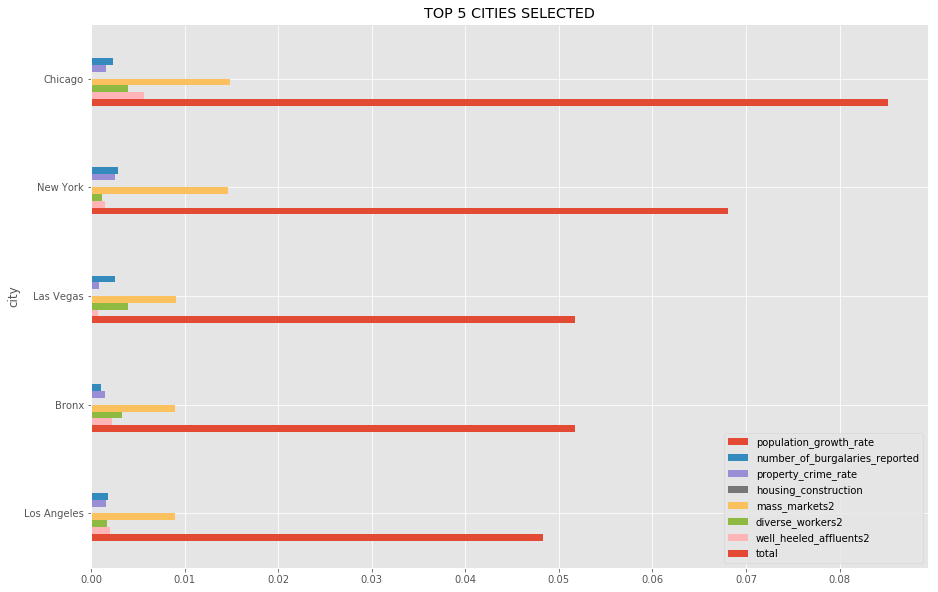

In [0]:
fig, (ax1) = plt.subplots(1, figsize=(15,10))
tb_final_5_cities.plot.barh(ax=ax1).invert_yaxis()
ax1.set_title('TOP 5 CITIES SELECTED')
plt.show()